In [2]:
import pandas as pd

In [3]:
data_2015=pd.read_csv('data/amazon_india_2015.csv')
data_2016=pd.read_csv('data/amazon_india_2016.csv')
data_2017=pd.read_csv('data/amazon_india_2017.csv')
data_2018=pd.read_csv('data/amazon_india_2018.csv')
data_2019=pd.read_csv('data/amazon_india_2019.csv')
data_2020=pd.read_csv('data/amazon_india_2020.csv')
data_2021=pd.read_csv('data/amazon_india_2021.csv')
data_2022=pd.read_csv('data/amazon_india_2022.csv')
data_2023=pd.read_csv('data/amazon_india_2023.csv')
data_2024=pd.read_csv('data/amazon_india_2024.csv')
data_2025=pd.read_csv('data/amazon_india_2025.csv')

In [4]:
df_2015=pd.DataFrame(data_2015)
df_2016=pd.DataFrame(data_2016)
df_2017=pd.DataFrame(data_2017)
df_2018=pd.DataFrame(data_2018)
df_2019=pd.DataFrame(data_2019)
df_2020=pd.DataFrame(data_2020)
df_2021=pd.DataFrame(data_2021)
df_2022=pd.DataFrame(data_2022)
df_2023=pd.DataFrame(data_2023)
df_2024=pd.DataFrame(data_2024)
df_2025=pd.DataFrame(data_2025)

In [5]:
df_list=[df_2015,df_2016,df_2017,df_2018,df_2019,df_2020,df_2021,df_2022,df_2023,df_2024,df_2025]
column=df_list[0].columns
count=0
for idx,i in enumerate(df_list,start=2015):
  if i.columns.to_list()==column.to_list():
    print(f"df_{idx}")
    count+=1
  else:
    print('no')
print(count)

df_2015
df_2016
df_2017
df_2018
df_2019
df_2020
df_2021
df_2022
df_2023
df_2024
df_2025
11


In [6]:
df_2015.columns.to_list()

['transaction_id',
 'order_date',
 'customer_id',
 'product_id',
 'product_name',
 'category',
 'subcategory',
 'brand',
 'original_price_inr',
 'discount_percent',
 'discounted_price_inr',
 'quantity',
 'subtotal_inr',
 'delivery_charges',
 'final_amount_inr',
 'customer_city',
 'customer_state',
 'customer_tier',
 'customer_spending_tier',
 'customer_age_group',
 'payment_method',
 'delivery_days',
 'delivery_type',
 'is_prime_member',
 'is_festival_sale',
 'festival_name',
 'customer_rating',
 'return_status',
 'order_month',
 'order_year',
 'order_quarter',
 'product_weight_kg',
 'is_prime_eligible',
 'product_rating']

In [7]:
df_final=pd.concat([df_2015,df_2016,df_2017,df_2018,df_2019,df_2020,df_2021,df_2022,df_2023,df_2024,df_2025])

In [8]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1127609 entries, 0 to 77384
Data columns (total 34 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   transaction_id          1127609 non-null  object 
 1   order_date              1127609 non-null  object 
 2   customer_id             1127609 non-null  object 
 3   product_id              1127609 non-null  object 
 4   product_name            1127609 non-null  object 
 5   category                1127609 non-null  object 
 6   subcategory             1127609 non-null  object 
 7   brand                   1127609 non-null  object 
 8   original_price_inr      1127609 non-null  object 
 9   discount_percent        1127609 non-null  float64
 10  discounted_price_inr    1127609 non-null  float64
 11  quantity                1127609 non-null  int64  
 12  subtotal_inr            1127609 non-null  float64
 13  delivery_charges        1037408 non-null  float64
 14  final_amo

In [9]:
# Q1: Clean and standardize dates
df_final["order_date"] = pd.to_datetime(
    df_final["order_date"],
    errors="coerce"
)

# Final format
df_final["order_date"] = df_final["order_date"].dt.strftime("%Y-%m-%d")


In [10]:
df_final['original_price_inr'].head(50)

0      123614.29
1       54731.86
2       97644.25
3      21,947.26
4       54731.86
5      131194.65
6       86987.64
7       32169.01
8       40264.16
9       54731.86
10      88664.85
11      73967.02
12       72564.1
13     209875.55
14      45363.47
15      23075.71
16      23075.71
17     114096.63
18      69584.33
19      38884.19
20      46234.09
21      15065.01
22      54731.86
23     164166.84
24      64917.57
25       29534.7
26      86477.53
27      86477.53
28      13721.42
29     118141.16
30      86591.57
31      86987.64
32      23264.31
33      94029.64
34      17206.23
35      37013.54
36     130430.24
37     130723.61
38      41408.67
39    ₹56,337.89
40     38,884.19
41      75380.48
42       23161.1
43       46680.9
44      43572.75
45      19375.09
46      86591.57
47       3896.99
48      20006.12
49      30990.65
Name: original_price_inr, dtype: object

In [11]:
import re
df_final['original_price_inr']=df_final['original_price_inr'].str.replace(r"[^\d.]",'',regex=True)

In [12]:
df_final['original_price_inr'].dtype

dtype('O')

In [13]:
df_final['original_price_inr'].head(40)

0     123614.29
1      54731.86
2      97644.25
3      21947.26
4      54731.86
5     131194.65
6      86987.64
7      32169.01
8      40264.16
9      54731.86
10     88664.85
11     73967.02
12      72564.1
13    209875.55
14     45363.47
15     23075.71
16     23075.71
17    114096.63
18     69584.33
19     38884.19
20     46234.09
21     15065.01
22     54731.86
23    164166.84
24     64917.57
25      29534.7
26     86477.53
27     86477.53
28     13721.42
29    118141.16
30     86591.57
31     86987.64
32     23264.31
33     94029.64
34     17206.23
35     37013.54
36    130430.24
37    130723.61
38     41408.67
39     56337.89
Name: original_price_inr, dtype: object

In [14]:
df_final['original_price_inr']=pd.to_numeric(df_final['original_price_inr'],errors='coerce')

Q3. Customer rating


In [15]:

df_final['customer_rating'].unique()

array(['5.0', '4.5', nan, '3.0', '4.0', '3.5', '4/5', '5.0 stars',
       '5.0/5.0', '4.5 stars', '3.5/5.0', '3/5', '4', '4.0 stars',
       '4.5/5.0', '5', '5/5', '4.0/5.0', '3.5 stars', '3.0 stars', '3',
       '3.0/5.0'], dtype=object)

In [16]:
import numpy as np
def clean_rating(x):
  if pd.isna(x):
    return np.nan
  x=str(x).lower().strip()
  if '/' in x:
    x=x.strip()
    num,den=x.split('/')
    return (float(num)/float(den))*5
  elif 'stars' in x:
    x=(x.split()[0])
    return float(x)
  else:
    try:
      return float(x)
    except:
      return np.nan

df_final['customer_rating']=df_final['customer_rating'].apply(clean_rating)

In [17]:
df_final['customer_rating'].dtype

dtype('float64')

City names

In [18]:
df_final['customer_city'].unique()

array(['Mumbai', 'Allahabad', 'Kolkata', 'Ludhiana', 'Delhi', 'Lucknow',
       'Jaipur', 'Bhubaneswar', 'Ahmedabad', 'Bangalore', 'Pune', 'Kochi',
       'Chennai', 'Nagpur', 'Visakhapatnam', 'mumba', 'Gorakhpur',
       'Bombay', 'Kanpur', 'Chandigarh', 'Hyderabad', 'Aligarh', 'Indore',
       'Patna', 'Meerut', 'Coimbatore', 'Vadodara', 'Saharanpur',
       'Bareilly', 'BANGALORE', 'Moradabad', 'New Delhi', 'Surat',
       'KOLKATA', 'Banglore', 'Madras', 'chenai', 'Delhi NCR', 'Varanasi',
       'Bengalore', 'Bengaluru', 'MUMBAI', 'Kolkata ', 'Calcutta',
       'delhi', 'CHENNAI', 'Chennai ', 'kolkata', 'Mumbai ', 'DELHI'],
      dtype=object)

In [19]:
city_map = {
    "Bombay": "mumbai",#
    "mumba": "mumbai",#
    "Mumbai ": "mumbai",#
    "MUMBAI": "mumbai",#


    "Bangalore": "bengaluru",
    'BANGALORE': "bengaluru",
    'Banglore': "bengaluru",
    'Bengalore': "bengaluru",
    'Bengaluru': "bengaluru",

    'Delhi': "delhi",
    'New Delhi': "delhi",
    'Delhi NCR': "delhi",
    'delhi': "delhi",
    'DELHI': "delhi",

    "kolkata": "kolkata",
    "Kolkata ": "kolkata",
    'KOLKATA': "kolkata",
    'Kolkata': "kolkata",


    'Chennai': "chennai",
    'chenai': "chennai",
    'CHENNAI': "chennai",
    'Chennai ': "chennai",
    'Madras': "chennai",

}
# i used map so if no value in dict then not replace it with anything still remain the same
df_final['customer_city'] = df_final['customer_city'].replace(city_map)

In [20]:
df_final['customer_city']=df_final['customer_city'].str.title()

In [21]:
df_final['customer_city'].unique()

array(['Mumbai', 'Allahabad', 'Kolkata', 'Ludhiana', 'Delhi', 'Lucknow',
       'Jaipur', 'Bhubaneswar', 'Ahmedabad', 'Bengaluru', 'Pune', 'Kochi',
       'Chennai', 'Nagpur', 'Visakhapatnam', 'Gorakhpur', 'Kanpur',
       'Chandigarh', 'Hyderabad', 'Aligarh', 'Indore', 'Patna', 'Meerut',
       'Coimbatore', 'Vadodara', 'Saharanpur', 'Bareilly', 'Moradabad',
       'Surat', 'Varanasi', 'Calcutta'], dtype=object)

In [22]:
df_final['customer_city'].dtype

dtype('O')

q5 Boolean Columns

In [23]:
# l=['True', 'False', 'FALSE', 'No', '0', '1', 'Yes', 'TRUE','True', 'No', 'False', 'TRUE', '1', 'Yes', '0', 'FALSE','No', 'False', 'FALSE', '0', 'True', '1', 'TRUE', 'Yes']
# print(list(set(l)))

# i used map so if no value in dict then replace it with np.nan
boolean_map={'TRUE':True, '0':False, 'FALSE':False, '1':True, 'False':False, 'Yes':True, 'No':False, 'True':True}

for col in ['is_prime_member','is_festival_sale','is_prime_eligible']:
   df_final[col]=df_final[col].str.lower().map(boolean_map)





Question 6 – Product Categories

In [24]:
#str.replace =exact string ya regex replace karta hai
df_final['category'].unique()
df_final['category']=df_final['category'].replace({'Electronics':'electronics','ELECTRONICS':'electronics',
                                                       'Electronics & Accessories':'electronics','Electronic':'electronics','Electronicss':'electronics'}).str.title()



In [25]:
df_final['category'].unique()

array(['Electronics'], dtype=object)

q7 Delivery days

In [26]:
df_final['delivery_days'].unique()

array(['6', '4', '3', '5', '7', 'Express', '0', '-1', 'Same Day',
       '1-2 days', '15', '1', '2'], dtype=object)

In [27]:
def clean_delivery(x):
  if pd.isna(x):
    return np.nan
  x=str(x).lower().strip()
  if '-' in x:
    first=(x.split('-')[0].strip())
    if first.isdigit():
      return int(first)
    else:
      return np.nan
  elif 'same'in x or'express' in x:
    return 0
  else:
   try:
    val=int(x)
    if val<0 and val>30:
      return np.nan
    return val
   except:
    return np.nan

df_final['delivery_days']=df_final['delivery_days'].apply(clean_delivery)


In [28]:
df_final['delivery_days'].astype('float').unique()

array([ 6.,  4.,  3.,  5.,  7.,  0., nan,  1., 15.,  2.])

In [29]:
df_final['delivery_days'].dtype

dtype('float64')

q8 Duplicate Transactions

In [30]:
df_final.columns


Index(['transaction_id', 'order_date', 'customer_id', 'product_id',
       'product_name', 'category', 'subcategory', 'brand',
       'original_price_inr', 'discount_percent', 'discounted_price_inr',
       'quantity', 'subtotal_inr', 'delivery_charges', 'final_amount_inr',
       'customer_city', 'customer_state', 'customer_tier',
       'customer_spending_tier', 'customer_age_group', 'payment_method',
       'delivery_days', 'delivery_type', 'is_prime_member', 'is_festival_sale',
       'festival_name', 'customer_rating', 'return_status', 'order_month',
       'order_year', 'order_quarter', 'product_weight_kg', 'is_prime_eligible',
       'product_rating'],
      dtype='object')

In [31]:
df_final=df_final.drop_duplicates(subset=['customer_id','product_id','order_date','original_price_inr'],keep='first')

q9 outliers

In [32]:
q1 = df_final["original_price_inr"].quantile(0.25)
q3 = df_final["original_price_inr"].quantile(0.75)
iqr = q3 - q1
lower_limit = q1 - 1.5*iqr
upper_limit = q3 + 1.5*iqr

# df.loc[condition,column]
df_final.loc[df_final["original_price_inr"] > upper_limit*10, "original_price_inr"] = np.nan


Question 10 – Payment Method

In [33]:
df_final.columns

Index(['transaction_id', 'order_date', 'customer_id', 'product_id',
       'product_name', 'category', 'subcategory', 'brand',
       'original_price_inr', 'discount_percent', 'discounted_price_inr',
       'quantity', 'subtotal_inr', 'delivery_charges', 'final_amount_inr',
       'customer_city', 'customer_state', 'customer_tier',
       'customer_spending_tier', 'customer_age_group', 'payment_method',
       'delivery_days', 'delivery_type', 'is_prime_member', 'is_festival_sale',
       'festival_name', 'customer_rating', 'return_status', 'order_month',
       'order_year', 'order_quarter', 'product_weight_kg', 'is_prime_eligible',
       'product_rating'],
      dtype='object')

In [34]:
df_final['payment_method'].unique()

array(['COD', 'Debit Card', 'Credit Card', 'Net Banking', 'UPI', 'Wallet',
       'BNPL'], dtype=object)

In [35]:
df_final.isnull().sum()

transaction_id                  0
order_date                 107666
customer_id                     0
product_id                      0
product_name                    0
category                        0
subcategory                     0
brand                           0
original_price_inr           2523
discount_percent                0
discounted_price_inr            0
quantity                        0
subtotal_inr                    0
delivery_charges            89761
final_amount_inr                0
customer_city                   0
customer_state                  0
customer_tier                   0
customer_spending_tier          0
customer_age_group         134646
payment_method                  0
delivery_days                6802
delivery_type                   0
is_prime_member           1088269
is_festival_sale          1088225
festival_name              773851
customer_rating            340003
return_status                   0
order_month                     0
order_year    

In [36]:
df_final.shape

(1122045, 34)

Fill na

In [37]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1122045 entries, 0 to 77383
Data columns (total 34 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   transaction_id          1122045 non-null  object 
 1   order_date              1014379 non-null  object 
 2   customer_id             1122045 non-null  object 
 3   product_id              1122045 non-null  object 
 4   product_name            1122045 non-null  object 
 5   category                1122045 non-null  object 
 6   subcategory             1122045 non-null  object 
 7   brand                   1122045 non-null  object 
 8   original_price_inr      1119522 non-null  float64
 9   discount_percent        1122045 non-null  float64
 10  discounted_price_inr    1122045 non-null  float64
 11  quantity                1122045 non-null  int64  
 12  subtotal_inr            1122045 non-null  float64
 13  delivery_charges        1032284 non-null  float64
 14  final_amo

In [38]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

order_date             107666
original_price_inr       2523
delivery_charges        89761
customer_age_group     134646
delivery_days            6802
is_prime_member       1088269
is_festival_sale      1088225
festival_name          773851
customer_rating        340003
is_prime_eligible     1088506
dtype: int64

In [39]:
df_final['order_date']=df_final['order_date'].ffill()

In [40]:
df_final['order_date'].isnull().sum()

np.int64(0)

In [41]:
df_final.columns

Index(['transaction_id', 'order_date', 'customer_id', 'product_id',
       'product_name', 'category', 'subcategory', 'brand',
       'original_price_inr', 'discount_percent', 'discounted_price_inr',
       'quantity', 'subtotal_inr', 'delivery_charges', 'final_amount_inr',
       'customer_city', 'customer_state', 'customer_tier',
       'customer_spending_tier', 'customer_age_group', 'payment_method',
       'delivery_days', 'delivery_type', 'is_prime_member', 'is_festival_sale',
       'festival_name', 'customer_rating', 'return_status', 'order_month',
       'order_year', 'order_quarter', 'product_weight_kg', 'is_prime_eligible',
       'product_rating'],
      dtype='object')

In [42]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

original_price_inr       2523
delivery_charges        89761
customer_age_group     134646
delivery_days            6802
is_prime_member       1088269
is_festival_sale      1088225
festival_name          773851
customer_rating        340003
is_prime_eligible     1088506
dtype: int64

In [43]:
df_final['customer_age_group'].dtype

dtype('O')

In [44]:
df_final['original_price_inr']=df_final['original_price_inr'].interpolate(method='linear',axis=0)
df_final['delivery_charges']=df_final['delivery_charges'].interpolate(method='linear',axis=0)


In [45]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

customer_age_group     134646
delivery_days            6802
is_prime_member       1088269
is_festival_sale      1088225
festival_name          773851
customer_rating        340003
is_prime_eligible     1088506
dtype: int64

In [46]:
df_final['customer_age_group']=df_final['customer_age_group'].fillna(df_final['customer_age_group'].mode()[0])

In [47]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

delivery_days           6802
is_prime_member      1088269
is_festival_sale     1088225
festival_name         773851
customer_rating       340003
is_prime_eligible    1088506
dtype: int64

In [48]:
df_final['customer_rating'].dtype

dtype('float64')

In [49]:
df_final['delivery_days']=df_final['delivery_days'].interpolate(method='linear',axis=0)

In [50]:
df_final['customer_rating']=df_final['customer_rating'].interpolate(method='linear',axis=0)

In [51]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

is_prime_member      1088269
is_festival_sale     1088225
festival_name         773851
is_prime_eligible    1088506
dtype: int64

In [52]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

is_prime_member      1088269
is_festival_sale     1088225
festival_name         773851
is_prime_eligible    1088506
dtype: int64

In [53]:
df_final['festival_name'].dtype

dtype('O')

In [54]:
df_final['festival_name']=df_final['festival_name'].fillna(df_final['festival_name'].mode()[0])

In [55]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

is_prime_member      1088269
is_festival_sale     1088225
is_prime_eligible    1088506
dtype: int64

In [56]:
df_final['is_prime_eligible'].dtype

dtype('O')

In [57]:
df_final['is_prime_eligible'].describe()

count     33539
unique        2
top        True
freq      27533
Name: is_prime_eligible, dtype: object

In [58]:
df_final['is_prime_eligible'].unique()

array([nan, True, False], dtype=object)

In [59]:
# series object par copy apply hota hai usme hum apni taraf se nai value ni daal sakte isliye inplace=True ni chalega
df_final['is_prime_eligible']=df_final['is_prime_eligible'].fillna('Unknown')

In [60]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

is_prime_member     1088269
is_festival_sale    1088225
dtype: int64

In [61]:
df_final['is_prime_member'].describe()

count     33776
unique        2
top       False
freq      20966
Name: is_prime_member, dtype: object

In [62]:
df_final['is_prime_member']=df_final['is_prime_member'].fillna('Unknown')

In [63]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

is_festival_sale    1088225
dtype: int64

In [64]:
df_final['is_festival_sale'].describe()

count     33820
unique        2
top       False
freq      23445
Name: is_festival_sale, dtype: object

In [65]:
pd.set_option('future.no_silent_downcasting', True)
df_final['is_festival_sale']=df_final['is_festival_sale'].fillna(df_final['is_festival_sale'].mode()[0])

In [66]:
df_final.isnull().sum()[df_final.isnull().sum()>0]

Series([], dtype: int64)

In [67]:
import sqlite3
import os
conn=sqlite3.connect('Amazon.db')
conn.close()

db_file = "Amazon.db"

if os.path.exists(db_file):
    os.remove(db_file)
    print(f"{db_file} deleted successfully!")
else:
    print(f"{db_file} not found.")



Amazon.db deleted successfully!


In [68]:
conn=sqlite3.connect("Amazon_data.db")

In [69]:
df_final.to_sql("Amazon_Sales_Table",conn,if_exists='replace',index=False)

1122045

Exploratory Data analysis

In [70]:
df_final.columns.to_list()

['transaction_id',
 'order_date',
 'customer_id',
 'product_id',
 'product_name',
 'category',
 'subcategory',
 'brand',
 'original_price_inr',
 'discount_percent',
 'discounted_price_inr',
 'quantity',
 'subtotal_inr',
 'delivery_charges',
 'final_amount_inr',
 'customer_city',
 'customer_state',
 'customer_tier',
 'customer_spending_tier',
 'customer_age_group',
 'payment_method',
 'delivery_days',
 'delivery_type',
 'is_prime_member',
 'is_festival_sale',
 'festival_name',
 'customer_rating',
 'return_status',
 'order_month',
 'order_year',
 'order_quarter',
 'product_weight_kg',
 'is_prime_eligible',
 'product_rating']

Q1 — Yearly revenue trend (2015–2025)

In [71]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# prettier plots
plt.style.use("seaborn-v0_8")
sns.set_theme()

# Parse dates
df_final["order_date"] = pd.to_datetime(
    df_final["order_date"], format="%Y-%m-%d", errors="coerce"
)

# Derived metrics
df_final["revenue"] = df_final["final_amount_inr"]
df_final["AOV"] = df_final["revenue"] / df_final["quantity"]

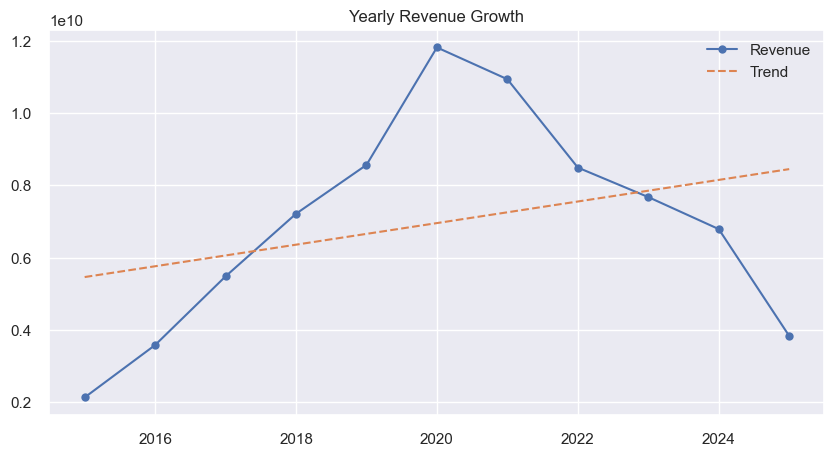

                 Revenue    Growth%
order_year                         
2015        2.130519e+09        NaN
2016        3.580009e+09  68.034579
2017        5.480430e+09  53.084251
2018        7.212716e+09  31.608583
2019        8.563849e+09  18.732664
2020        1.181417e+10  37.953968
2021        1.093462e+10  -7.444866
2022        8.490434e+09 -22.352736
2023        7.674142e+09  -9.614261
2024        6.788378e+09 -11.542183
2025        3.832237e+09 -43.547096


In [72]:

rev = df_final.groupby("order_year")["revenue"].sum()
pct = rev.pct_change() * 100
plt.figure(figsize=(10,5))
plt.plot(rev.index, rev.values, marker="o", label="Revenue")
z = np.polyfit(rev.index, rev.values, 1)
plt.plot(rev.index, np.poly1d(z)(rev.index), "--", label="Trend")
plt.title("Yearly Revenue Growth")
plt.legend()
plt.show()
print(pd.DataFrame({"Revenue":rev, "Growth%":pct}))

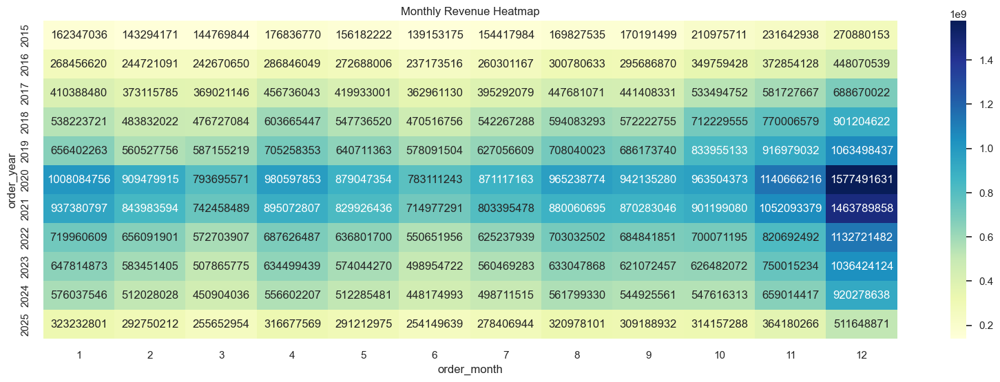

In [73]:
# =========================================
# Q2. Seasonal Patterns (Monthly Heatmap)
# =========================================
monthly = df_final.groupby(["order_year","order_month"])["revenue"].sum().unstack(fill_value=0)
plt.figure(figsize=(20,6))
sns.heatmap(monthly, annot=True, fmt=".0f", cmap="YlGnBu")
plt.title("Monthly Revenue Heatmap")
plt.show()


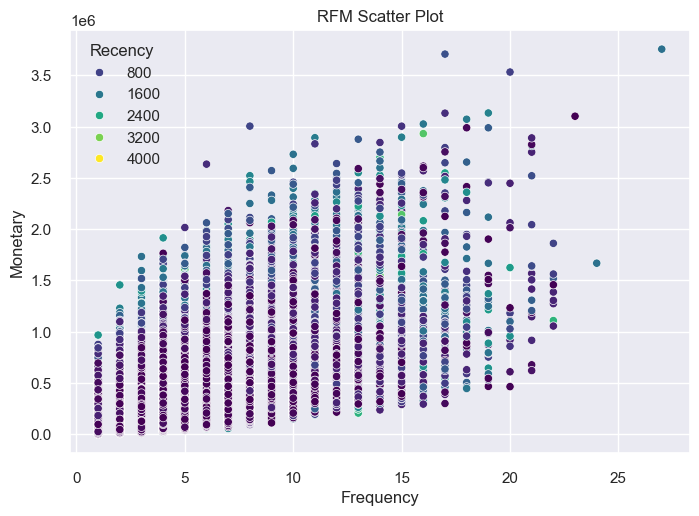

In [74]:
# =========================================
# Q3. RFM Segmentation
# =========================================
snapshot = df_final["order_date"].max() + pd.Timedelta(days=1)
rfm = df_final.groupby("customer_id").agg({
    "order_date": lambda x: (snapshot - x.max()).days,
    "transaction_id": "count",
    "revenue": "sum"
}).rename(columns={"order_date":"Recency","transaction_id":"Frequency","revenue":"Monetary"})
sns.scatterplot(data=rfm, x="Frequency", y="Monetary", hue="Recency", palette="viridis")
plt.title("RFM Scatter Plot")
plt.show()


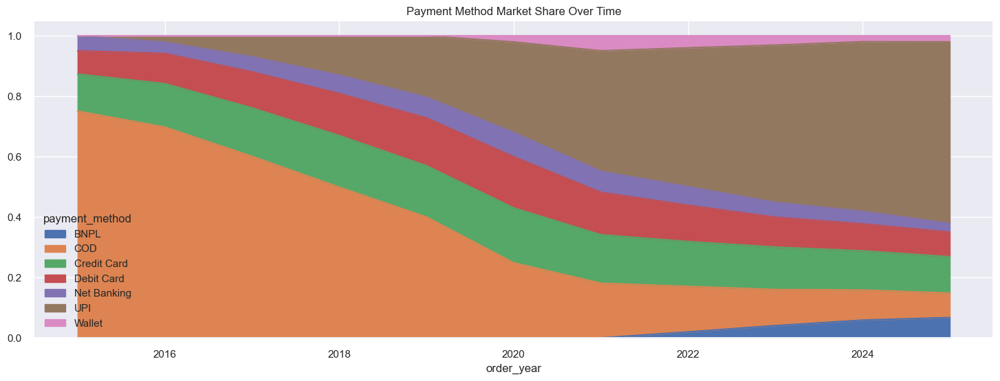

In [75]:
# =========================================
# Q4. Payment Method Evolution
# =========================================
pm = df_final.groupby(["order_year","payment_method"])["revenue"].sum().unstack(fill_value=0)
pm.div(pm.sum(axis=1), axis=0).plot.area(figsize=(18,6))
plt.title("Payment Method Market Share Over Time")
plt.show()


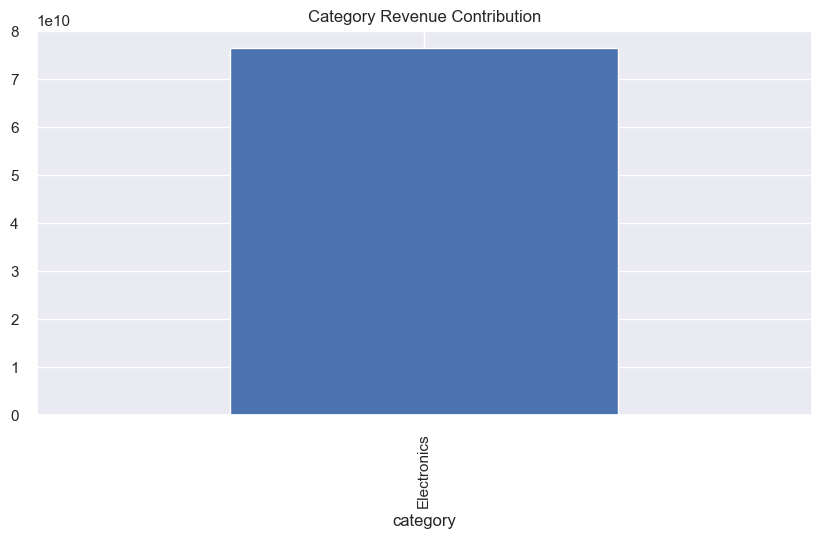

In [76]:
# =========================================
# Q5. Category-wise Performance
# =========================================
cat_rev = df_final.groupby("category")["revenue"].sum().sort_values(ascending=False)
cat_rev.plot(kind="bar", figsize=(10,5))
plt.title("Category Revenue Contribution")
plt.show()

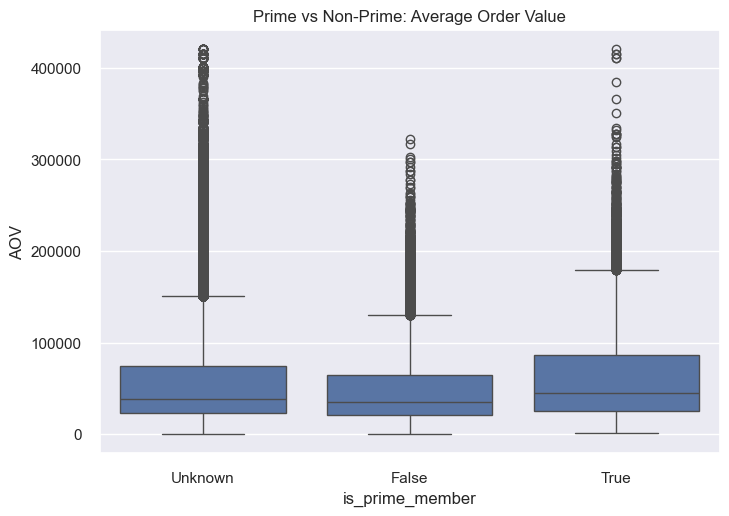

In [77]:
# =========================================
# Q6. Prime vs Non-Prime Customers
# =========================================
sns.boxplot(data=df_final, x="is_prime_member", y="AOV")
plt.title("Prime vs Non-Prime: Average Order Value")
plt.show()


In [78]:
# =========================================
# Q7. Geographic Analysis
# =========================================
state_rev = df_final.groupby("customer_state")["revenue"].sum().reset_index()
px.bar(state_rev, x="customer_state", y="revenue", title="Revenue by State").show()


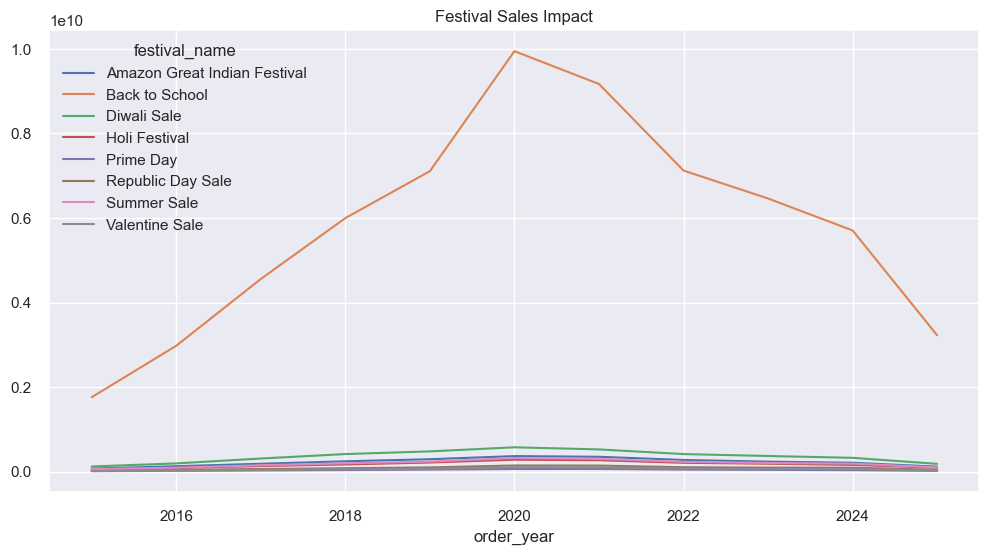

In [79]:
# =========================================
# Q8. Festival Sales Impact
# =========================================
festivals = df_final.groupby(["festival_name","order_year"])["revenue"].sum().unstack(fill_value=0)
festivals.T.plot(kind="line", figsize=(12,6))
plt.title("Festival Sales Impact")
plt.show()


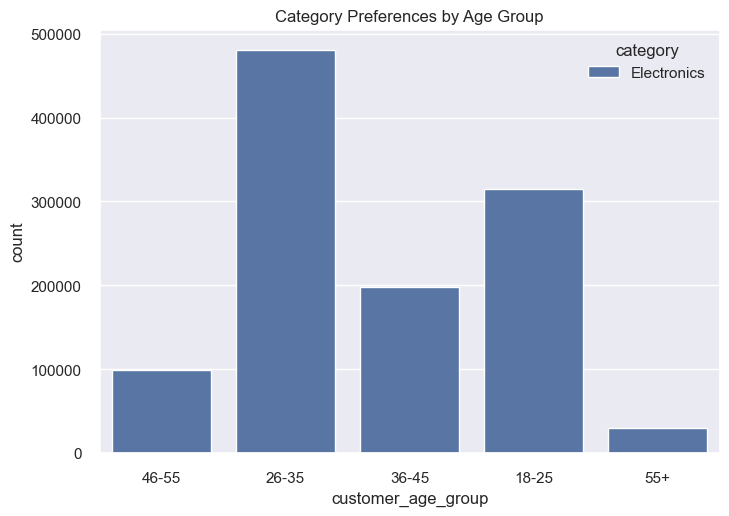

In [80]:
# =========================================
# Q9. Age Group Preferences
# =========================================
sns.countplot(data=df_final, x="customer_age_group", hue="category")
plt.title("Category Preferences by Age Group")
plt.show()

c:\Users\Vishal Singla\Documents\Amazon_Project\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



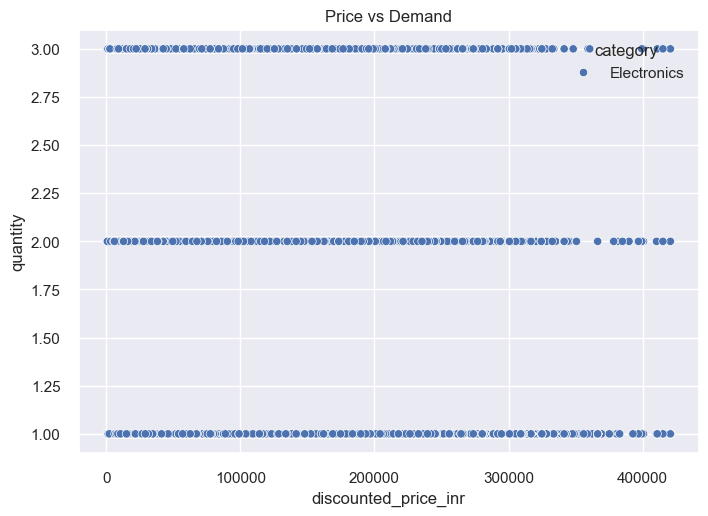

In [81]:
# =========================================
# Q10. Price vs Demand
# =========================================
sns.scatterplot(data=df_final, x="discounted_price_inr", y="quantity", hue="category")
plt.title("Price vs Demand")
plt.show()


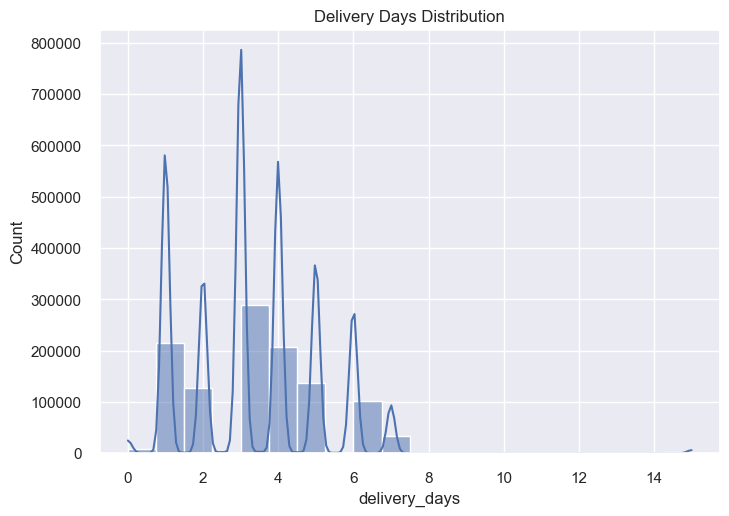

In [82]:
# =========================================
# Q11. Delivery Performance
# =========================================
sns.histplot(df_final["delivery_days"], bins=20, kde=True)
plt.title("Delivery Days Distribution")
plt.show()


In [85]:
df_final['return_status'].unique()

array(['Delivered', 'Returned', 'Cancelled'], dtype=object)

In [ ]:

# =========================================
# Q12. Returns & Satisfaction
# =========================================
return_rate = df_final.groupby("category")["return_status"].mode()
return_rate.plot(kind="bar", figsize=(10,5))
plt.title("Return Rate by Category")
plt.show()#later 

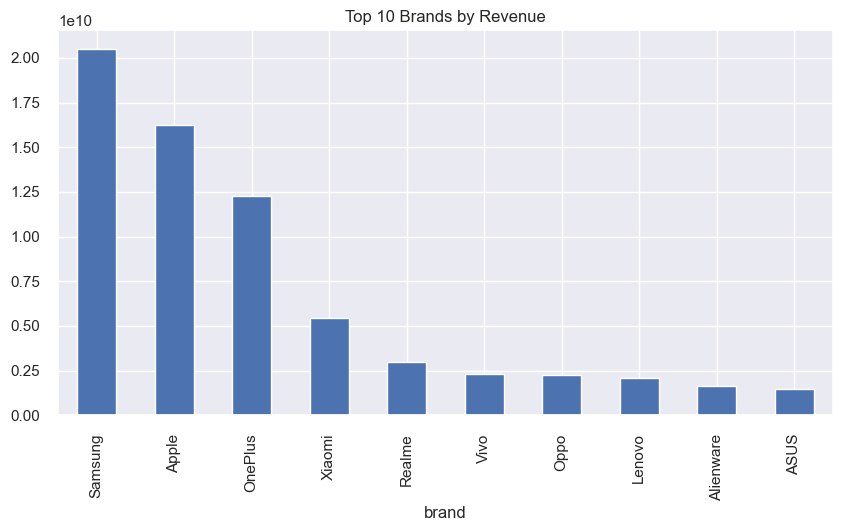

In [ ]:
# =========================================
# Q13. Brand Performance
# =========================================
brand_share = df_final.groupby("brand")["revenue"].sum().nlargest(10)
brand_share.plot(kind="bar", figsize=(10,5))
plt.title("Top 10 Brands by Revenue")
plt.show()

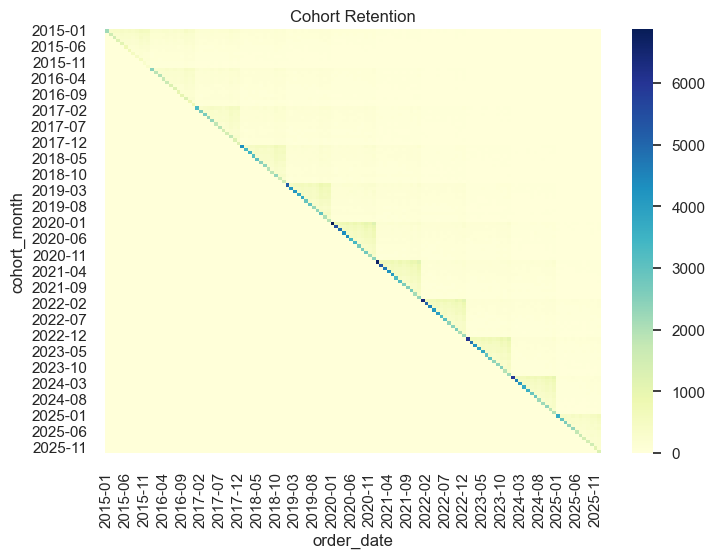

In [ ]:
# =========================================
# Q14. Customer Lifetime Value (Cohorts)
# =========================================
df_final["cohort_month"] = df_final.groupby("customer_id")["order_date"].transform("min").dt.to_period("M")
cohort = df_final.groupby(["cohort_month", df_final["order_date"].dt.to_period("M")])["customer_id"].nunique().unstack()
sns.heatmap(cohort.fillna(0), cmap="YlGnBu")
plt.title("Cohort Retention")
plt.show()

c:\Users\Vishal Singla\Documents\Amazon_Project\venv\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



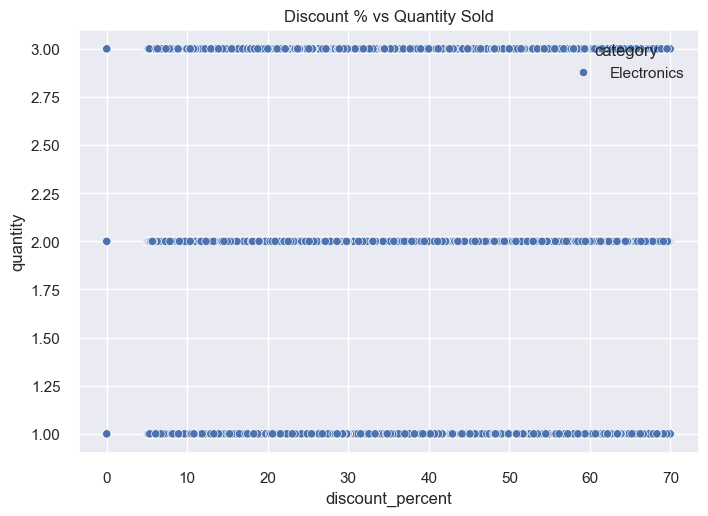

In [ ]:
# =========================================
# Q15. Discount Effectiveness
# =========================================
sns.scatterplot(data=df_final, x="discount_percent", y="quantity", hue="category")
plt.title("Discount % vs Quantity Sold")
plt.show()

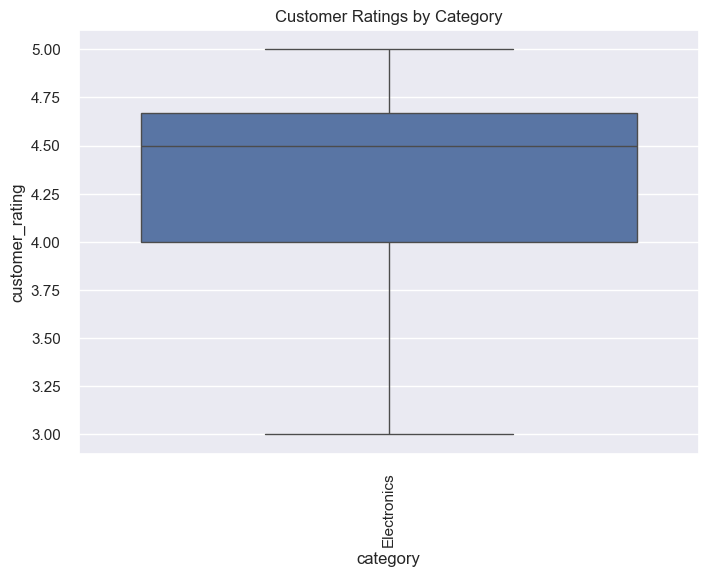

In [ ]:
# =========================================
# Q16. Rating Patterns
# =========================================
sns.boxplot(data=df_final, x="category", y="customer_rating")
plt.title("Customer Ratings by Category")
plt.xticks(rotation=90)
plt.show()

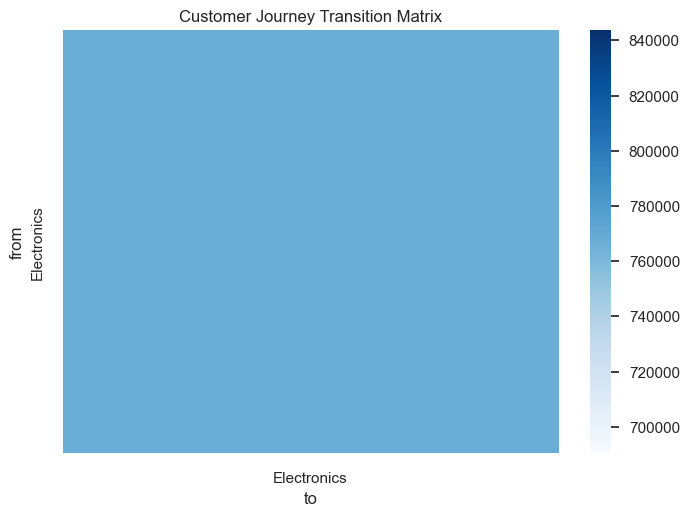

In [ ]:
# =========================================
# Q17. Customer Journey (Transitions)
# =========================================
transitions = []
for cid, g in df_final.sort_values("order_date").groupby("customer_id"):
    cats = g["category"].tolist()
    transitions += [(cats[i], cats[i+1]) for i in range(len(cats)-1)]
trans_df = pd.DataFrame(transitions, columns=["from","to"])
tm = trans_df.groupby(["from","to"]).size().unstack(fill_value=0)
sns.heatmap(tm, cmap="Blues")
plt.title("Customer Journey Transition Matrix")
plt.show()

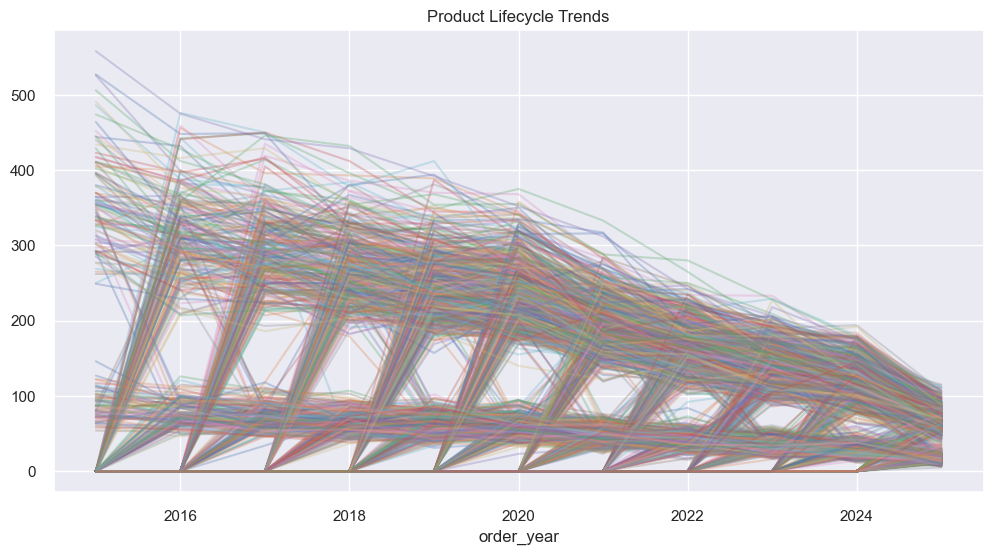

In [ ]:
# =========================================
# Q18. Product Lifecycle
# =========================================
life = df_final.groupby(["product_id","order_year"])["quantity"].sum().unstack(fill_value=0)
life.T.plot(figsize=(12,6), alpha=0.3, legend=False)
plt.title("Product Lifecycle Trends")
plt.show()

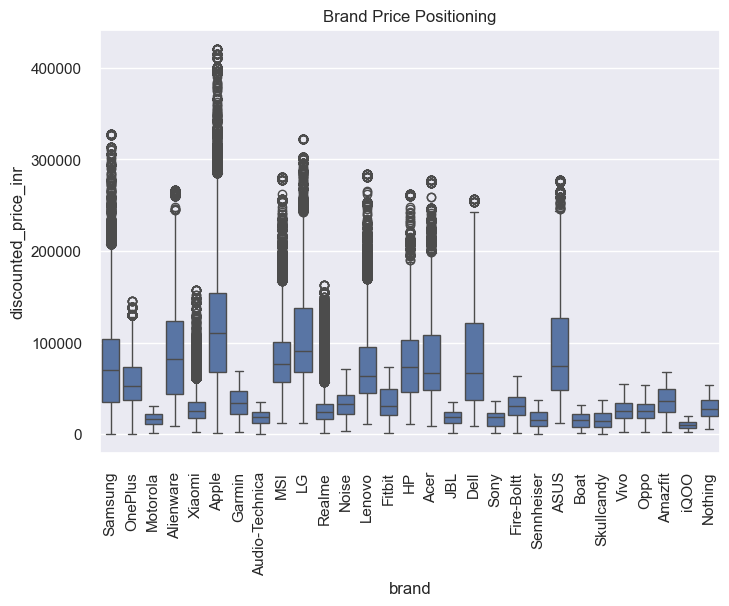

In [ ]:
# =========================================
# Q19. Competitive Pricing
# =========================================
sns.boxplot(data=df_final, x="brand", y="discounted_price_inr")
plt.xticks(rotation=90)
plt.title("Brand Price Positioning")
plt.show()

In [ ]:
# =========================================
# Q20. Business Health Dashboard (KPIs)
# =========================================
kpis = {
    "Total Revenue": df_final["revenue"].sum(),
    "Total Orders": df_final["transaction_id"].nunique(),
    "Active Customers": df_final["customer_id"].nunique(),
    "Return Rate": df_final[;].mean()*100,
    "Prime %": df_final["is_prime_member"].mean()*100
}
print("📊 Business Health KPIs")
for k,v in kpis.items():
    print(f"{k}: {v:,.2f}")

TypeError: Could not convert string 'DeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredCancelledCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledReturnedDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredCancelledReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredCancelledDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedReturnedReturnedReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredReturnedReturnedDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedReturnedDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedCancelledDeliveredDeliveredReturnedCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredReturnedDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredReturnedDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredCancelledDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDeliveredDelivered' to numeric